# Joining data

After cleaning and saving both the ACS and the summarized NYC Taxi data, we create the final dataset that will be fed to the model

In [19]:
import pandas as pd
import numpy as np
import geopandas
demo = geopandas.read_feather(r'..\data\interim\acs.feather')
trips = pd.read_feather(r'..\data\interim\nyc_taxi_data_by_block.feather')
trips['geoid'] = trips['geoid'].astype(np.int64)
trips = trips.set_index('geoid')
df = demo.merge(trips, how='left', on='geoid')
df.head()

,geometry,amerindian_pop,asian_pop,black_pop,commuters_16_over,commuters_by_public_transportation,employed_pop,families_with_young_children,family_households,female_pop,...,owner_occupied_housing_units_median_value,pop_16_over,renter_occupied_housing_units_paying_cash_median_gross_rent,total_pop,two_or_more_races_pop,unemployed_pop,vacant_housing_units,vacant_housing_units_for_rent,white_pop,avg
geoid,,,,,,,,,,,,,,,,,,,,,
360050001001,"POLYGON ((-73.89277 40.79284, -73.89261 40.792...",25.0,125.0,3984.0,0.0,0.0,0.0,0.0,0.0,577.0,...,666774.63487,7080.0,1530.544541,7080.0,41.0,0.0,0.0,0.0,538.0,1.352941
360050002001,"POLYGON ((-73.86285 40.81267, -73.86191 40.812...",0.0,0.0,468.0,608.0,271.0,608.0,63.0,356.0,1024.0,...,384200.00000,1543.0,1793.000000,1919.0,0.0,168.0,30.0,0.0,13.0,NaN
360050002002,"POLYGON ((-73.86708 40.81444, -73.86332 40.812...",0.0,0.0,238.0,579.0,161.0,588.0,96.0,363.0,773.0,...,415300.00000,1423.0,1358.000000,1703.0,0.0,118.0,71.0,15.0,52.0,1.166667
360050002003,"POLYGON ((-73.85856 40.80665, -73.85848 40.806...",0.0,104.0,202.0,382.0,108.0,382.0,33.0,239.0,481.0,...,374700.00000,718.0,1677.000000,920.0,0.0,9.0,57.0,0.0,12.0,1.000000
360050004001,"POLYGON ((-73.85972 40.81527, -73.85956 40.815...",0.0,24.0,24.0,213.0,69.0,259.0,0.0,136.0,227.0,...,363900.00000,417.0,1375.000000,468.0,0.0,0.0,15.0,15.0,0.0,1.000000


There is missing pickup data for some of the blocks. We will remove this lines later to feed out model.

In [20]:
df.isna().sum(axis=0)

geometry                                                         0
amerindian_pop                                                   0
asian_pop                                                        0
black_pop                                                        0
commuters_16_over                                                0
commuters_by_public_transportation                               0
employed_pop                                                     0
families_with_young_children                                     0
family_households                                                0
female_pop                                                       0
hispanic_pop                                                     0
households                                                       0
housing_units                                                    0
housing_units_renter_occupied                                    0
income_per_capita                                             

# Visualization

Before proceeding to train the model let's create some visualizations to check that everything is correct so far. First we take a look at a heatmap of the average daily pickups.

## Map

<AxesSubplot:>

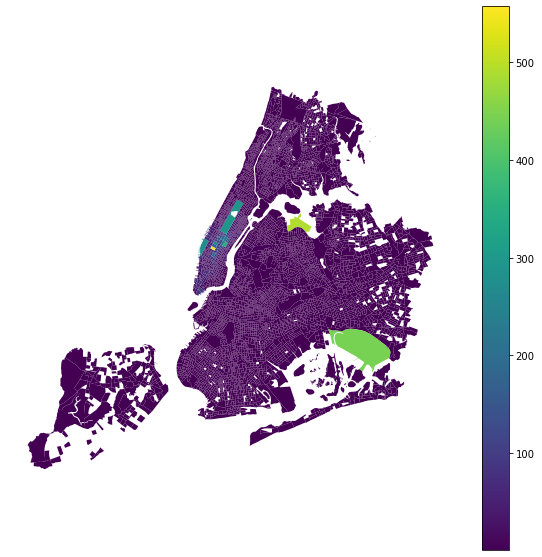

In [21]:
import matplotlib.pyplot as plt
fig, ax = plt.subplots(figsize=(10, 10))
ax.axis('off')
df.plot(column='avg', ax=ax, legend=True )

There are two hot spots in green/yellow that stand out over all. These correspond to the JFK (the bigger one on the right) and LGA (the smaller one) airports. It seems logical that they have a high rate of taxi pickups.

The turquoise rectangle left to LGA is Central Park, one of the most popular attractions of the city that receives millions of tourists every year. so it also logicall to think that it will have a lot of taxi rides.

## Target

It's also useful to visualize the distribution of the target.

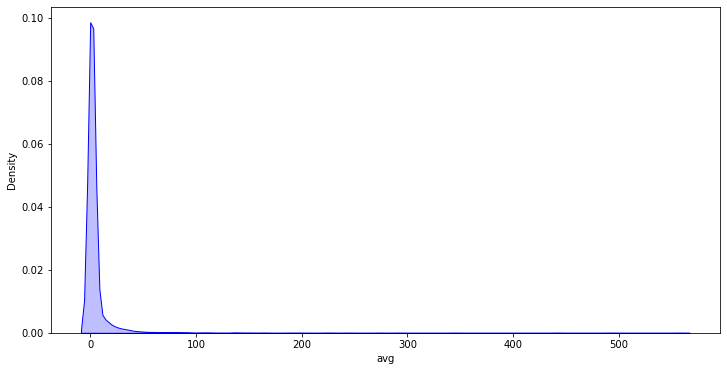

In [22]:
import seaborn as sns

fig, ax = plt.subplots(figsize=(12, 6))
ax = sns.distplot(
    df['avg'],
    ax=ax,
    hist=False,
    rug=False,
    color="blue",
    kde_kws={'shade': True, 'linewidth': 1}
)

It's easy to see the correlation with the map visualization. Most of the blocks are represented around the peak of the distribution, with less than maybe 25 daily average pickups. Only a few blocks make up for the long tail of the distribution.

## Variables

To better understand the variables present in the census data and their possible connection to the average pickups, we can take a look at their distribution and correlation to the target


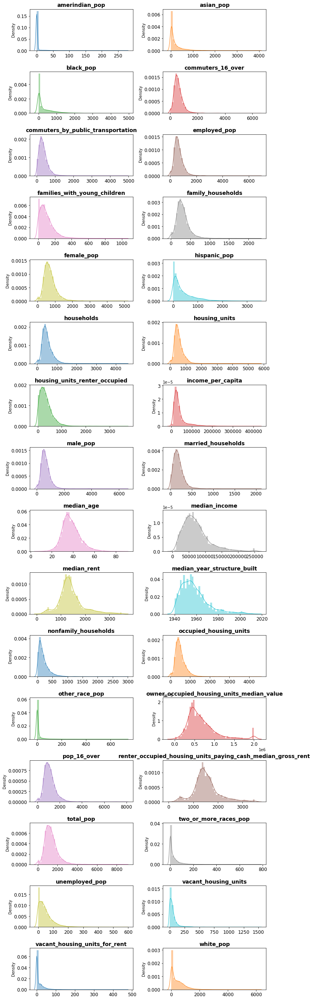

In [23]:
fig, axes = plt.subplots(nrows=16, ncols=2, figsize=(10, 40))
axes = axes.flat
columns = df.select_dtypes(include=['float64', 'int64']).columns
columns = columns.drop('avg')

for i, col in enumerate(columns):

    sns.distplot(
        df[col],
        hist    = True,
        rug     = False,
        color   = (list(plt.rcParams['axes.prop_cycle'])*4)[i]["color"],
        kde_kws = {'shade': False, 'linewidth': 1},
        ax      = axes[i]
    )
    axes[i].set_title(col, fontsize = 14, fontweight = "bold")
    axes[i].tick_params(labelsize = 12)
    axes[i].set_xlabel("")

fig.tight_layout()
plt.subplots_adjust(top = 0.9)

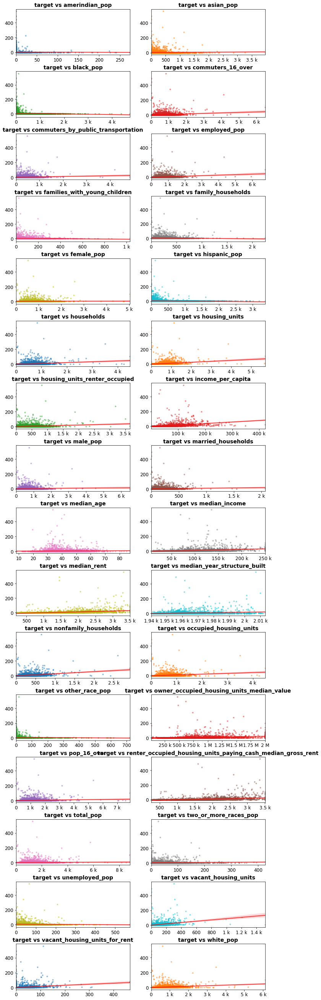

In [24]:
import matplotlib.ticker as ticker
fig, axes = plt.subplots(nrows=16, ncols=2, figsize=(10, 40))
axes = axes.flat
columns = df.select_dtypes(include=['float64', 'int64']).columns
columns = columns.drop('avg')

for i, col in enumerate(columns):
    sns.regplot(
        x           = df[col],
        y           = df['avg'],
        color       = (list(plt.rcParams['axes.prop_cycle'])*4)[i]["color"],
        marker      = '.',
        scatter_kws = {"alpha":0.4},
        line_kws    = {"color":"r","alpha":0.7},
        ax          = axes[i]
    )
    axes[i].set_title(f"target vs {col}", fontsize = 14, fontweight = "bold")
    axes[i].yaxis.set_major_formatter(ticker.EngFormatter())
    axes[i].xaxis.set_major_formatter(ticker.EngFormatter())
    axes[i].tick_params(labelsize = 12)
    axes[i].set_xlabel("")
    axes[i].set_ylabel("")

fig.tight_layout()
plt.subplots_adjust(top=0.9)

It seems none of the available variables shows strong correlation to the target.